# Musical key classification
Machine Learning - `WMAI010-05`
Classifying keys in a piece of music using a Hidden Markov Model trained using Spotify data. For a Notebook containing the results, see [results notebook](https://dunnkers.com/music-key-classification/results.html).

In [1]:
from IPython.display import Video
Video("example/39C5FuZ8C8M0QI8CrMsPkR.mp4")

## Data Exploration
Let's visualize our data: the Chroma vectors obtained from the Spotify API. We'll take 1 sample to begin with.

Import packages

In [2]:
# local imports
from tracklist import TrackList
from data import load_analysis
# data science
import pandas as pd
from scipy import stats
import numpy as np
from scipy.stats import entropy
# plotting
import seaborn as sns
from matplotlib.animation import FuncAnimation
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
# notebook
from IPython.display import HTML
import IPython
from IPython.display import set_matplotlib_formats
%matplotlib inline
set_matplotlib_formats('svg')

In [3]:
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (13, 5),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
pylab.rcParams.update(params)

Define variable

In [4]:
pitch_classes = {
    0: 'C (also B♯, D#)',
    1: 'C♯, D♭ (also B#)',
    2: 'D (also C#, E#)',
    3: 'D♯, E♭ (also F#)',
    4: 'E (also D#, F♭)',
    5: 'F (also E♯, G#)',
    6: 'F♯, G♭ (also E#)',
    7: 'G (also F#, A#)',
    8: 'G♯, A♭',
    9: 'A (also G#, B#)',
    10: 'A♯, B♭ (also C#)',
    11: 'B (also A#, C♭)'
}
data_dir = '../dataset'
song = 0
trim_length = 20

Load data

In [5]:
meta = TrackList.load_from_dir(data_dir)
all_tracks = meta.get_track_ids()

## Investigate a single song

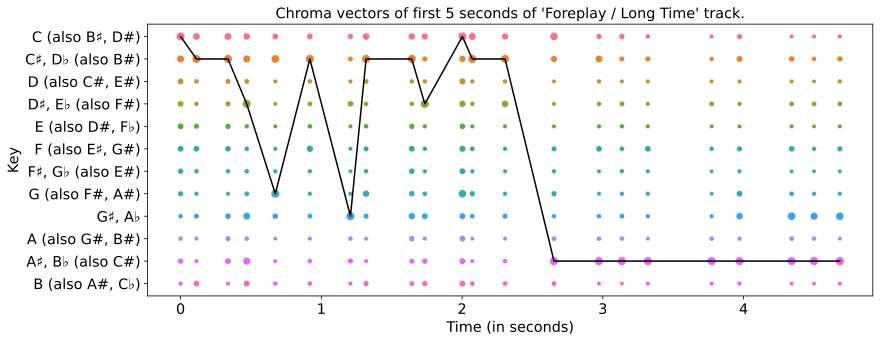

In [6]:
track_df = pd.read_csv('example/39C5FuZ8C8M0QI8CrMsPkR.txt')
max_pitch = track_df.groupby('start')['pitch'].transform(max) == track_df['pitch']
linedf = track_df[max_pitch]
sns.scatterplot(x='start', y='chroma', size='pitch',
    data=track_df[track_df['start'] < 5], hue='chroma', legend=False)
plt.plot(linedf[linedf['start'] < 5].start, linedf[linedf['start'] < 5].chroma, color="black")
plt.xlabel('Time (in seconds)')
plt.ylabel('Key')
plt.title('Chroma vectors of first 5 seconds of \'Foreplay / Long Time\' track.')
plt.show()

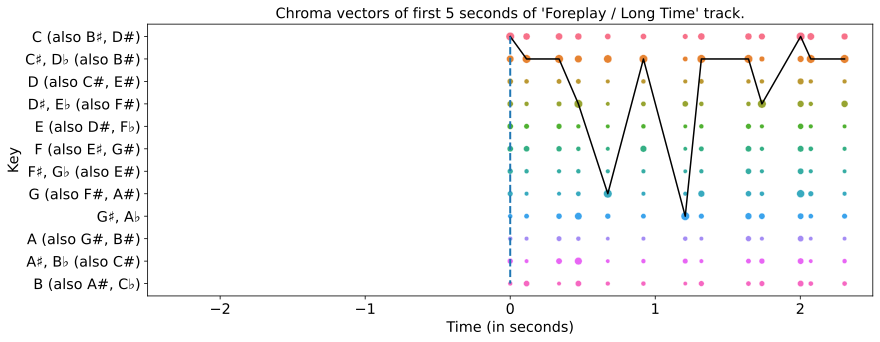

In [7]:
def create_frame(frame, ax): # arguments are `frame number` and `fargs`
    ax.cla()
    window = 5 # show a window of 5 seconds
    step = frame/20 # advance 0.05 seconds per frame
    x1 = -window/2 + step
    x2 = window/2 + step
    scattersamples = (track_df['start'] >= x1) & (track_df['start'] <= x2)
    sns.scatterplot(x='start', y='chroma', size='pitch',
        data=track_df[scattersamples], ax=ax, hue='chroma', legend=False)
    linesamples = (linedf['start'] >= x1) & (linedf['start'] <= x2)
    plt.plot(linedf[linesamples].start, linedf[linesamples].chroma, color="black")
    ax.set_xlim(x1, x2)
    line1, = ax.plot(
            [x1+window/2, x1+window/2],
            ['C (also B♯, D#)', 'B (also A#, C♭)'],
            '--', linewidth=2, label='Dashes set retroactively')
    plt.xlabel('Time (in seconds)')
    plt.ylabel('Key')
    plt.title('Chroma vectors of first 5 seconds of \'Foreplay / Long Time\' track.')
fig = plt.figure()
ax = fig.gca()
create_frame(0, ax)

Animation size has reached 20984501 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


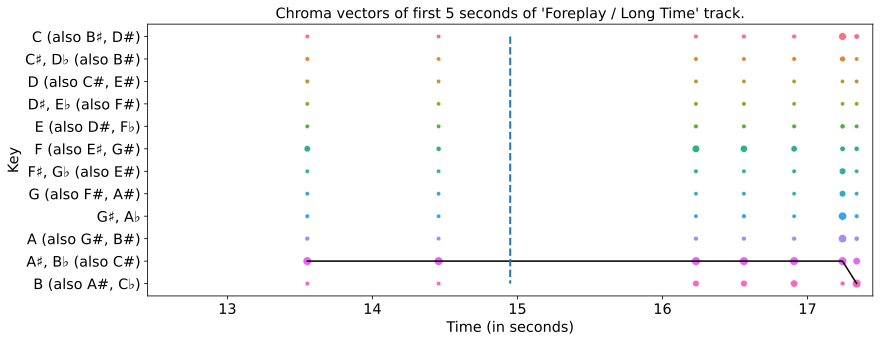

In [8]:
fig = plt.figure()
ax = fig.gca()
animation = FuncAnimation(fig, create_frame, frames=300, fargs=(ax,),
    interval=50) # Interval at 1000/50 = 20 frames per second
HTML(animation.to_jshtml())

## Investigate overall dataset

In [9]:
analyses = [load_analysis(data_dir, track) for track in all_tracks]
df = pd.DataFrame([analyses[i]["key"] for i in range(len(all_tracks))], columns=["pitch"])
df['key_confidences'] = [analyses[i]["key_confidence"] for i in range(len(all_tracks))]
df['modes'] = [analyses[i]["mode"] for i in range(len(all_tracks))]
df['mode_confidences'] = [analyses[i]["mode_confidence"] for i in range(len(all_tracks))]
df['durations'] = [sum(analyses[i]["duration"]) for i in range(len(all_tracks))]
df['no_segments'] = [len(analyses[i]["duration"]) for i in range(len(all_tracks))]
df['segment_lens'] = [np.mean(analyses[i]['duration']) for i in range(len(all_tracks))]
df['entropies'] = [np.mean(entropy(analyses[i]['pitches'], base=12)) for i in range(len(all_tracks))]
df = df.loc[df.modes != -1]
df.describe()

,pitch,key_confidences,modes,mode_confidences,durations,no_segments,segment_lens,entropies
count,9885.000000,9885.000000,9885.000000,9885.000000,9885.000000,9885.000000,9885.000000,9885.000000
mean,5.501669,0.468523,0.499848,0.499016,20.186137,72.577845,0.305839,1.552397
std,3.450717,0.242407,0.500025,0.176986,0.749655,16.422775,0.915750,0.133378
min,0.000000,0.000000,0.000000,0.000000,10.866660,1.000000,0.117180,0.000000
25%,3.000000,0.305000,0.000000,0.388000,20.067430,62.000000,0.242977,1.480225
50%,6.000000,0.479000,0.000000,0.510000,20.137250,73.000000,0.278156,1.566260
75%,8.000000,0.638000,1.000000,0.619000,20.236590,83.000000,0.324700,1.641503
max,11.000000,1.000000,1.000000,1.000000,90.700090,171.000000,90.700090,2.036006


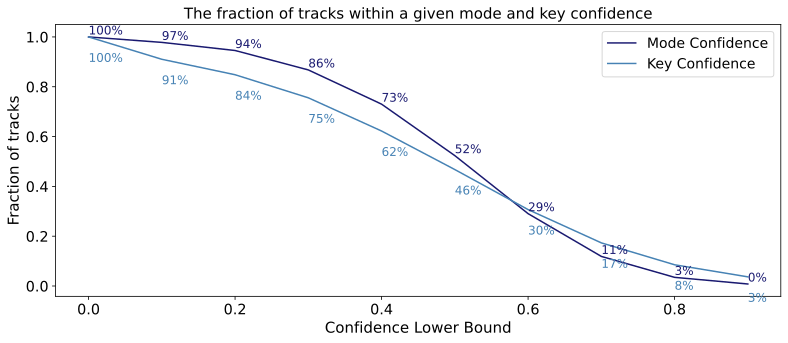

In [10]:
mode_intervals = [len(df[df.mode_confidences >= i])/len(df) for i in np.arange(0, 1, 0.1)]
plt.plot(np.arange(0, 1, 0.1), mode_intervals, label="Mode Confidence", color="midnightblue")
key_intervals = [len(df[df.key_confidences >= i])/len(df) for i in np.arange(0, 1, 0.1)]
plt.plot(np.arange(0, 1, 0.1), key_intervals, label="Key Confidence", color="steelblue")
plt.xlabel('Confidence Lower Bound', fontsize=15)
plt.ylabel('Fraction of tracks', fontsize=15)
plt.title(f'The fraction of tracks within a given mode and key confidence', fontsize=15)
for i, v in zip(np.arange(0, 1, 0.1), mode_intervals):
    plt.text(i, v+0.01, str(int(v*100))+"%", fontsize=12, color="midnightblue")
for i, v in zip(np.arange(0, 1, 0.1), key_intervals):
    plt.text(i, v-0.1, str(int(v*100))+"%", fontsize=12, color="steelblue")
plt.legend(fontsize=14)
plt.show()

Double check that we have selected an equal amount of each key and mode

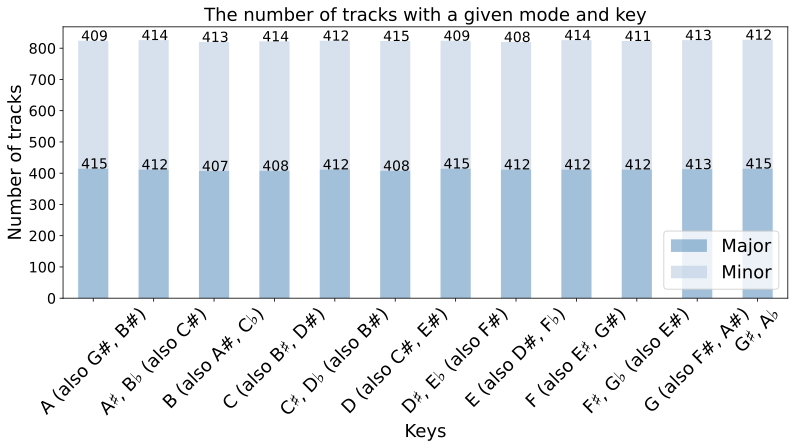

In [11]:
pal = ["steelblue", "lightsteelblue"]
df_comb = df.replace({"pitch": pitch_classes}).replace({"modes": {0: "Minor", 1: "Major"}})[["pitch", "modes"]]
barplot = df_comb.groupby(['pitch', 'modes']).size().unstack().plot(kind='bar', stacked=True, alpha=0.5, color=pal)
for i in range(12):
    major = df_comb.groupby(['pitch', 'modes']).size().unstack().Major[i]
    minor = df_comb.groupby(['pitch', 'modes']).size().unstack().Minor[i]
    plt.text(i-0.2, major, major, fontsize=14, color="black")
    plt.text(i-0.2, major+minor, minor, fontsize=14, color="black")
plt.xticks(rotation=45, fontsize=18)
plt.xlabel('Keys', fontsize=18)
plt.ylabel('Number of tracks', fontsize=18)
plt.title(f'The number of tracks with a given mode and key', fontsize=18)
plt.legend(fontsize=18, loc="lower right")
plt.show()

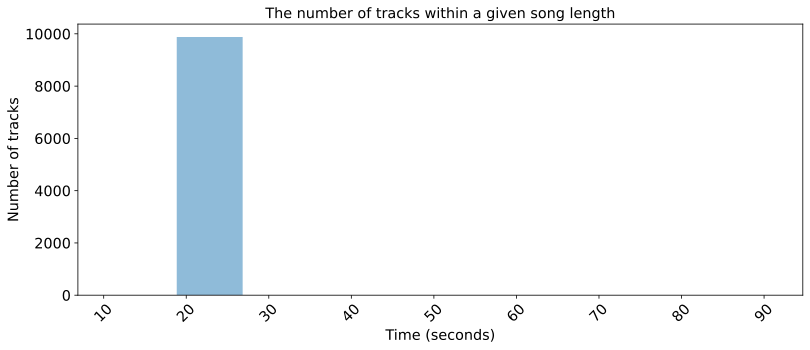

In [12]:
plt.hist(df.durations, alpha=0.5)
plt.xticks(rotation=45)
plt.xlabel('Time (seconds)')
plt.ylabel('Number of tracks')
plt.title(f'The number of tracks within a given song length')
plt.show()

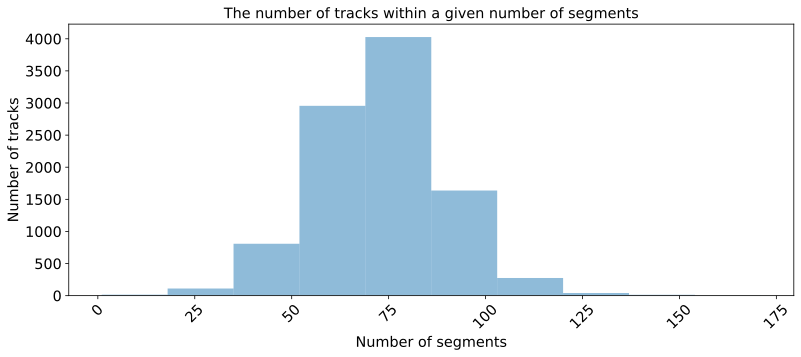

In [13]:
plt.hist(df.no_segments, alpha=0.5)
plt.xticks(rotation=45)
plt.xlabel('Number of segments')
plt.ylabel('Number of tracks')
plt.title(f'The number of tracks within a given number of segments')
plt.show()

Compare Trimmed songs to not trimmed

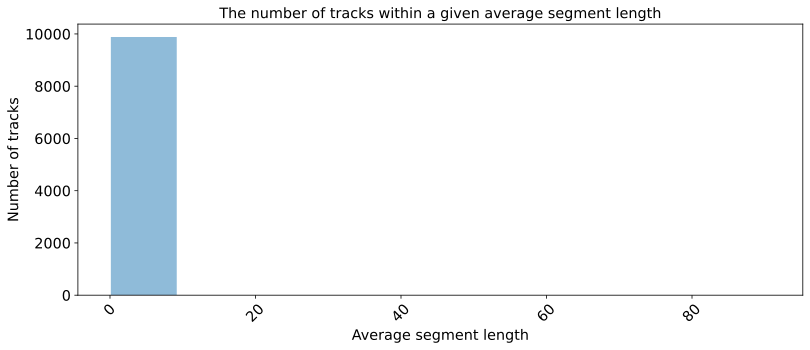

In [14]:
plt.hist(df.segment_lens, alpha=0.5)
plt.xticks(rotation=45)
plt.xlabel('Average segment length')
plt.ylabel('Number of tracks')
plt.title(f'The number of tracks within a given average segment length')
plt.show()

## About
Built by Jeroen Overschie, Jordan Barkai, Thijs Havinga and Pieter Dekker - as part of the Machine Learning course `WMAI010-05` taught on the University of Groningen.